# **CLASSIFICAZIONE DEI PUNTI DI INTERESSE DI UN SITO CULTURALE MEDIANTE OBJECT RECOGNITION**

**Machine Learning 2021/2022**

**Michele Ferro 1000037665**



# 0 - Accesso a Google Drive

Il dataset fornito per l'esecuzione di questo task è stato caricato su Google Drive. Viene utilizzata la libreria fornita direttamente da Colab, affinché il Drive di Google possa essere montato.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

%cd /content 
!rm -rf sample_data
!cp drive/MyDrive/'Colab Notebooks'/ML_Project/Dataset/2_Points_of_Interest_Recognition.zip . || echo "2_Points_of_Interest_Recognition.zip copied"
!cp drive/MyDrive/'Colab Notebooks'/ML_Project/Projects.zip . || echo "Project.zip copied"
!cp drive/MyDrive/'Colab Notebooks'/ML_Project/train_freeze.py . || echo "train_freeze.py copied"
!unzip 2_Points_of_Interest_Recognition.zip >> /dev/null || echo "dataset extracted"
!unzip Projects.zip >> /dev/null || echo "Previously saved models extracted"
!mv "Points Of Interest Recognition" dataset
!rm 2_Points_of_Interest_Recognition.zip
!rm Projects.zip
!umount drive
!rmdir drive

Mounted at /content/drive
/content


# 1 - Download di YOLOv5

L'object utilizzato per il rilevamento dei punti di interesse è YOLOv5, versione compatibile con PyTorch e disponibile al seguente [repository GitHub](https://github.com/ultralytics/yolov5). 

Al fine di poterlo utilizzare in qualsiasi ambiente, Colab compreso, è necessario anzitutto installare mediante il modulo `pip` le dovute dipendenze, indicate nel file `requirements.txt`.


In [ ]:
!git clone https://github.com/ultralytics/yolov5.git
!mv train_freeze.py yolov5
%cd yolov5
!pip install -r requirements.txt

import torch
from IPython.display import Image, clear_output
clear_output()
device = "cuda" if torch.cuda.is_available() else "cpu"
if device == 'cuda':
  print("TORCH VERSION: " + torch.__version__ + "\nUSING DEVICE: " + str(torch.cuda.get_device_properties(device)))

TORCH VERSION: 1.11.0+cu113
USING DEVICE: _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15109MB, multi_processor_count=40)


In [ ]:
!nvidia-smi

Sat Jun  4 14:45:54 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   41C    P8    10W /  70W |      3MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

Di seguito sono mostrati due esempi di inferenze sul modello di base pre-addestrato, effettuate mediante lo script `detect.py`:

detect: weights=['yolov5l.pt'], source=data/images/, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-244-g47233e1 Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

100% 89.3M/89.3M [00:00<00:00, 124MB/s]

Fusing layers... 
YOLOv5l summary: 367 layers, 46533693 parameters, 0 gradients
image 1/2 /content/yolov5/data/images/bus.jpg: 640x480 4 persons, 1 bus, Done. (0.041s)
image 2/2 /content/yolov5/data/images/zidane.jpg: 384x640 2 persons, 1 tie, Done. (0.039s)
Speed: 0.5ms pre-process, 40.1ms inference, 21.3ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp


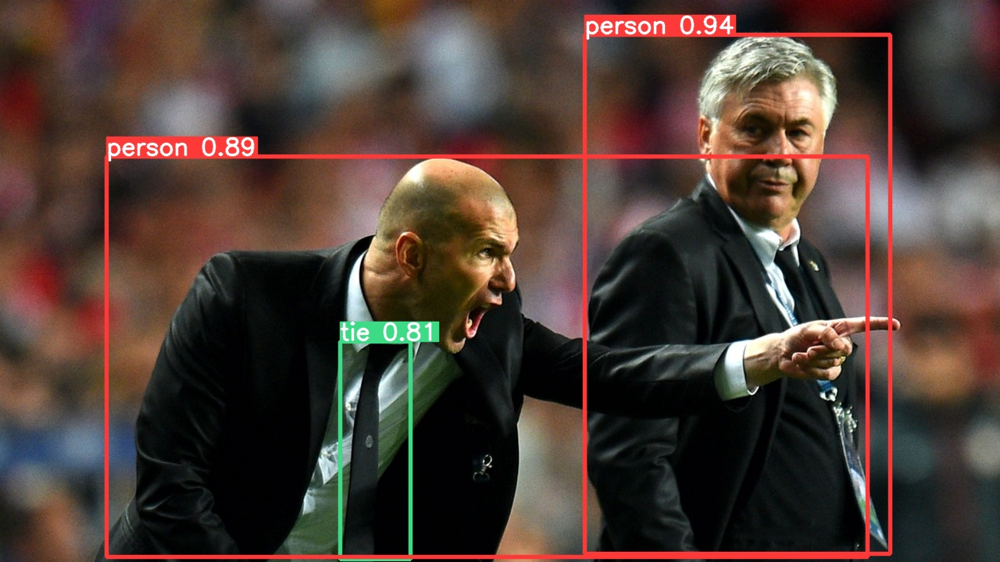

In [ ]:
!python detect.py --weights yolov5l.pt --img 640 --conf 0.25 --source data/images/
Image(filename='runs/detect/exp/zidane.jpg', width=600)

detect: weights=['yolov5l.pt'], source=data/images/, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-244-g47233e1 Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
YOLOv5l summary: 367 layers, 46533693 parameters, 0 gradients
image 1/2 /content/yolov5/data/images/bus.jpg: 640x480 4 persons, 1 bus, Done. (0.059s)
image 2/2 /content/yolov5/data/images/zidane.jpg: 384x640 2 persons, 1 tie, Done. (0.043s)
Speed: 3.2ms pre-process, 50.7ms inference, 1.7ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp2


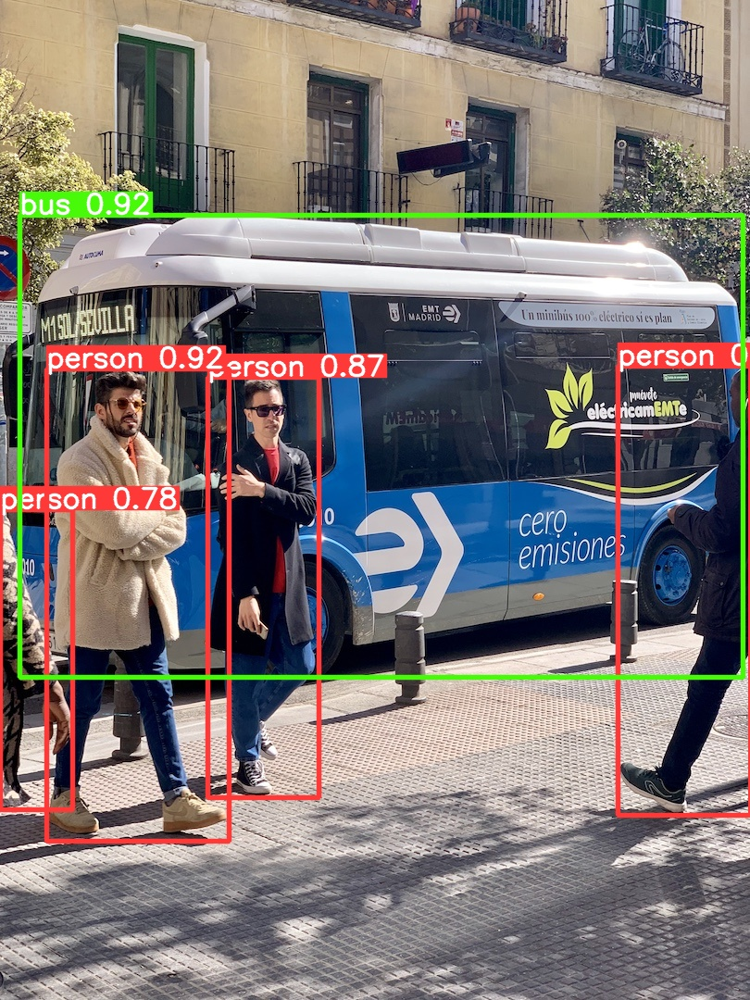

In [ ]:
!python detect.py --weights yolov5l.pt --img 640 --conf 0.25 --source data/images/
Image(filename='runs/detect/exp/bus.jpg', width=600)

# 2 - Interventi sul Dataset
Al momento, il dataset fornito si presenta del tutto inutilizzabile sull'object detector, per cui sono definite una serie di procedure Python, al fine di poterlo rendere utilizzabile.

Vengono anzitutto inseriti i path dei due subset in un dizionario.

In [ ]:
import os

folders = {
  'benedettini': os.path.join('/','content','dataset','Monastero dei Benedettini'),
  'bellomo': os.path.join('/','content','dataset','Palazzo Bellomo'),
}

## 2.1 Rinomina
La procedura qui di seguito, rinomina le sottocartelle `YOLO_annotations` in `labels`.\
Inoltre, sposta alcuni dei file `.txt` presenti nelle cartelle `images` esattamente nel path che YOLO si aspetterebbe, ossia `labels`.

In [ ]:
# rinomina cartelle bbox_annotations in labels

import shutil

# rinomina cartelle bbox_annotations in labels
def rename_labels_folder(site):
  source_train = os.path.join(folders[site],'Training')
  source_test = os.path.join(folders[site],'Test')
  if site == 'benedettini':
    source_val = os.path.join(folders[site],'Validation')
    os.chdir(source_val)
    try:
      os.rename('YOLO_annotations','labels')
    except:
      None

  os.chdir(source_train)
  try:
    os.rename('YOLO_annotations','labels')
  except:
    None

  os.chdir(source_test)
  try:
    os.rename('YOLO_annotations','labels')
  except:
    None

  print('bbox_annotations folders have been renamed in labels!')

# sposta file .txt presenti nelle cartelle images nelle relative cartelle images
def move_labels(site):
  source = os.path.join(folders[site],'Training')
  for d in os.scandir(source):
    if site != 'bellomo':
      os.chdir(os.path.join(d,'images'))
      im_d = os.getcwd()
    else:
      im_d = d
    for f in os.listdir(im_d):
      if f[len(f)-4:len(f)] == '.txt':
        try: shutil.move(os.path.join(im_d,f),os.path.join(d,'labels'))
        except: os.remove(os.path.join(im_d,f))
  print('All label files have been moved in the appropriate label folder!')

# aggiunge _ sostituendo blank char nei label di validazine
def repair_val_names(site):
  if site == 'benedettini':
    source_test = os.path.join(folders[site],'Validation','labels')
  elif site == 'bellomo':
    source_test = os.path.join(folders[site],'Test','labels')
  for f in os.listdir(source_test):
    if ' ' in f:
        new_f = f.replace(' ','_')
        os.rename(os.path.join(source_test,f),os.path.join(source_test,new_f))
  print('Validation filenames repaired!')

## 2.2 Riparazione delle etichette
La procedure mostrate qui di seguito, riparano i file di etichettatura presenti nelle cartelle `label` di ambedue i subset.
La riparazione consiste nel richiamare la procedura `treshold(site, mode)`, la quale, richiamando le due ulteriori procedure `norm_coords(filename, site)` e `repair_label_and_trash(filename)`, esegue le seguenti operazioni:
- se i file di etichettatura presentano dimensioni di bounding box non normalizzate, esse vengono normalizzate (considerando, naturalmente, le dimensioni delle immagini sui rispettivi subset);
- una volta normalizzate (o se già normalizzate) viene eseguita una sogliatura per quei valori leggermente superiori a 1.0 o leggermente inferiori a 0.0, i quali potrebbero dare un errore durante il passaggio dei file a YOLO.

In [ ]:
# normalizza coordinate di bounding box
def norm_coords(filename, site):
  not_norm = False
  if site == 'benedettini':
    im_size = {'w':1216, 'h':684}
  elif site == 'bellomo':
    im_size = {'w':1280, 'h':720}
  with open(filename,'r') as f:
    coords = []
    norm_coords = []
    count = 0
    for line in f:
        count += 1
        coords.append([float(c) for c in line.strip().split(' ')])
    for i in range(count):
      for j in range(1,4):
        if coords[i][j] > 1.5:
          not_norm = True
      if not_norm: 
        coords[i][0] = int(coords[i][0])
        x = coords[i][1] / im_size['w']
        y = coords[i][2] / im_size['h']
        w = coords[i][3] / im_size['w']
        h = coords[i][4] / im_size['h']
        norm_coords.append([coords[i][0],x,y,w,h])

  if not_norm: 
    with open(filename,'w+') as f:
      for i in range(count):
        for j in range(len(norm_coords[i])):
          f.write(str(norm_coords[i][j])+' ')
        f.write('\n')

In [ ]:
def repair_label_and_tresh(filename):
  with open(filename,'r') as f:
    coords = [ ]
    count = 0
    for line in f:
      count += 1
      coords.append([float(c) for c in line.strip().split(' ')])
    for i in range(count):
      coords[i][0] = int(coords[i][0])
      for j in range(1,len(coords[i])):
        # treshold
        if coords[i][j] < 0: coords[i][j] = 0
        elif coords[i][j] > 1.0: coords[i][j] = 1.0

  with open(filename,'w+') as f:
    for i in range(count):
      for j in range(len(coords[i])):
        f.write(str(coords[i][j])+' ')
      f.write('\n')

In [ ]:
def treshold(site, mode='train'):
  if site == 'bellomo':
    modes = {
      'train': os.path.join('Training','labels'),
      'val': os.path.join('Test','labels')
    }
  elif site == 'benedettini':
    modes = {
      'train': os.path.join('Training'),
      'val': os.path.join('Validation','labels')
    }

  source = os.path.join(folders[site],modes[mode])

  # se nella cartella bellomo o in modalità di validazione
  # (hanno struttura simile)
  if site == 'bellomo':
    for d in os.listdir(source):
      #if mode != 'val':
        os.chdir(os.path.join(source,d))
        i_dir = os.getcwd()
        for filename in os.listdir(i_dir):
          norm_coords(filename,site)
          repair_label_and_tresh(filename)
  # se cartella benedettini
  elif site == 'benedettini' and mode != 'val':
    for d in os.scandir(source):
      os.chdir(os.path.join(d,'labels'))
      i_dir = os.getcwd()
      for filename in os.listdir(i_dir):
        norm_coords(os.path.join(i_dir,filename),site)
        repair_label_and_tresh(os.path.join(i_dir,filename))
  # se cartella benedettini, in modalità val
  elif site == 'benedettini' and mode == 'val':
    for filename in os.listdir(source):
      norm_coords(os.path.join(source,filename),site)
      repair_label_and_tresh(os.path.join(source,filename))
  # se cartella benedettini, in modalità di training
  else:
    for d in os.scandir(source):
      os.chdir(d)
      os.chdir('labels')
      i_dir = os.getcwd()
      for filename in os.listdir(i_dir):
        norm_coords(filename,site)
        repair_label_and_tresh(filename)
  
  os.chdir('/content')                                    # ritorna alla home 

La proceura `repair_bellomo_folders()` fa sì che le sottocartelle in `images`, presenti nel subset di Palazzo Bellomo, abbiamo lo stesso nome delle rispettive cartelle presenti in `labels`.

In [ ]:
def repair_bellomo_folders():
  source_im = os.path.join(folders['bellomo'],'Training','images')
  source_lab = os.path.join(folders['bellomo'],'Training','labels')

  for d_im in os.listdir(source_im):
    for d_lab in os.listdir(source_lab):
      if len(d_im) == 3:
        if d_im == d_lab[:3]:
          try:
            shutil.move(os.path.join(source_im, d_im), os.path.join(source_im, d_lab))
          except: None
      elif len(d_im) == 4:
        if d_im == d_lab[:4]:
          try:
            shutil.move(os.path.join(source_im, d_im), os.path.join(source_im, d_lab))
          except: None
  
  print('images folder names have been repaired')

La procedura `repair_bellomo_files_per_folder()` fa sì che ogni file immagine condivida la nomenclatura con il relativo file di etichettatura (escludendo l'estensione, naturalmente).

In [ ]:
def repair_bellomo_files_per_folder():
  source_im = os.path.join(folders['bellomo'],'Training','images')
  source_lab = os.path.join(folders['bellomo'],'Training','labels')

  for d_im in os.scandir(source_im):
    for f_im in os.listdir(d_im):
      if f_im[:5] == 'frame':
        new_fn = f_im[5::]
        shutil.move(os.path.join(d_im, f_im), os.path.join(d_im, new_fn))
              
  for d_lab in os.scandir(source_lab):
    for f_lab in os.listdir(d_lab):
      if f_lab[:5] == 'frame':
        new_fn = f_lab[5::]
        shutil.move(os.path.join(d_lab, f_lab), os.path.join(d_im, new_fn))
  
  print('images and labels names have been repaired')

## 2.3 Creazione del file `.yaml` di configurazione
Le procedure mostrate di seguito, generano invece lo `yaml` di configurazione dei subset, il quale indica il path dei set di training, di test e di validazione facendo riferimento ai rispettivi file `.txt`, i quali, a loro volta, indicano i path di ogni singola immagine.\
In particolare, la procedura `write_yaml(site)`, preso come input l'identificatore del sito, richiama le due ulteriori procedure `write_file_ls(site, mode)` e `write_names(site)`, dove:
- la prima, crea i file `.txt` che reindirizzano ai fotogrammi presenti in ogni set, e relativi al sito scelto (nel caso della validazione, vengono scartati tutti i file con etichette superiori al numero effettivo di classe, visto che è presente questo problema sul dataset);
- la seconda, individua i nomi delle classi (mediante i nomi delle cartelle che contengono i vari fotogrammi), per poi mandare in output il loro numero e una lista contenente le stringhe che identifica le rispettive cartelle.

In [ ]:
def write_file_ls(site, mode='train'):
  if site == 'bellomo':
    modes = {
        'train': os.path.join('Training','images'),
        'val': os.path.join('Test','images'),
        'test': os.path.join('Test','images')
    }
  elif site == 'benedettini':
    modes = {
        'train': os.path.join('Training'),
        'val': os.path.join('Validation','images'),
        'test': os.path.join('Test')
    }

  source = os.path.join(folders[site],modes[mode])

  ben_val_labels = os.path.join(folders[site],'Validation','labels')
  bell_train_labels = os.path.join(folders[site],'Training','labels')

  bell_test_labels = os.path.join(folders[site],'Test','labels')

  fn = mode + '_' + site + '.txt'
  with open(os.path.join('/','content',fn), 'w+') as f:
    # se nella cartella bellomo o in modalità di validazione
    # (hanno struttura simile)
    if site == 'bellomo':
      if mode == 'train':
        for d in os.listdir(bell_train_labels):
          for filename in os.listdir(os.path.join(bell_train_labels,d)):
            im_fn = filename[:-4] + '.jpg'
            with open(os.path.join(bell_train_labels,d,filename),'r') as l:
              coords = []
              for line in l:
                coords.append([float(c) for c in line.strip().split(' ')])
            class_exceed = False
            if len(coords) > 0:
              for i in range(len(coords)):
                if coords[i][0] > 56 or coords[i][0] < 0:
                  class_exceed = True
              if not class_exceed:
                #print('train:',coords)
                f.write(os.path.join(folders[site],modes[mode],d,im_fn)+'\n')
      if mode == 'val':
        for d in os.listdir(bell_test_labels):
          for filename in os.listdir(os.path.join(bell_test_labels,d)):
            im_fn = filename[:-4] + '.jpg'
            with open(os.path.join(bell_test_labels,d,filename),'r') as l:
              coords = []
              for line in l:
                coords.append([float(c) for c in line.strip().split(' ')])
            class_exceed = False
            if len(coords) > 0:
              for i in range(len(coords)):
                if coords[i][0] > 56 or coords[i][0] < 0:
                  class_exceed = True
              if not class_exceed:
                #print('val:', coords)
                f.write(os.path.join(folders[site],modes[mode],d,im_fn)+'\n')
    # se cartella benedettini, in modalità di test
    elif site == 'benedettini' and mode == 'test':
      for d in os.scandir(source):
        for filename in os.listdir(d):
          f.write(os.path.join(d,filename)+'\n')
    # se cartella benedettini, in modalità val
    elif site == 'benedettini' and mode == 'val':
      for filename in os.listdir(ben_val_labels):
        im_fn = filename[:-4] + '.jpg'
        # ignora il file, se la classe è superiore a 37
        with open(os.path.join(ben_val_labels,filename), 'r') as l:
          coords = []
          for line in l:
              coords.append([float(c) for c in line.strip().split(' ')])
        if len(coords) > 0:
          if coords[0][0] <= 35:
            f.write(os.path.join(folders[site],modes[mode],im_fn)+'\n')
    # se cartella benedettini, in modalità di training
    else:
      for d in os.scandir(source):
        os.chdir(d)
        os.chdir('images')
        i_dir = os.getcwd()
        for filename in os.listdir(i_dir):
          f.write(os.path.join(i_dir,filename)+'\n') if filename[-1] == 'g' else None
    
    os.chdir('/content')                                    # ritorna alla home 
  return os.path.abspath(f.name)                            # manda in output il path del file 

In [ ]:
# ritorna numero di classi e lista di classi

def write_names(site):
  source = os.path.join(folders[site],'Training') if site == 'benedettini' else os.path.join(folders[site],'Training','images')
  classes = 0
  names = []
  for d in os.listdir(source):
    classes += 1
    names.append(str(d))

  return classes, names

In [ ]:
# crea yaml yolov5

import yaml

def write_yaml(site):
  n_classes, names = write_names(site)
  filename = site + '.yaml'

  yml = {
      'path': folders[site],
      'train': write_file_ls(site, 'train'),
      'val': write_file_ls(site, 'val'),
      'test': write_file_ls(site, 'test'),

      'nc': n_classes,
      'names': names
  }

  with open(os.path.join('/','content',filename),'w') as file:
    yaml.dump(yml,file,default_flow_style=None,sort_keys=False)

  print(filename, 'has been written')

## 2.4 Esecuzione delle procedure

Vengono qui richiamate le procedure precedentemente definite e descritte:

In [ ]:
rename_labels_folder('benedettini')
move_labels('benedettini')
repair_val_names('benedettini')
treshold('benedettini','train')
treshold('benedettini','val')
write_yaml('benedettini')

bbox_annotations folders have been renamed in labels!
All label files have been moved in the appropriate label folder!
Validation filenames repaired!
benedettini.yaml has been written


In [ ]:
rename_labels_folder('bellomo')
repair_bellomo_folders()
repair_bellomo_files_per_folder()
move_labels('bellomo')
repair_val_names('bellomo')
treshold('bellomo','train')
treshold('bellomo','val')
write_yaml('bellomo')

bbox_annotations folders have been renamed in labels!
images folder names have been repaired
images and labels names have been repaired
All label files have been moved in the appropriate label folder!
Validation filenames repaired!
bellomo.yaml has been written


# 3 - YOLOv5s

## 3.1 - Primo tentativo di training

Viene eseguito un primo training sull'intero modello.

L'addestramento verrà eseguito per 5 epoche e con input di risoluzione dimezzata rispetto all'originale.

### Monastero dei Benedettini

In [ ]:
!python /content/yolov5/train.py --img 608 --batch 64 --epochs 5 --data /content/benedettini.yaml --weights yolov5s.pt --project "/content/Projects" --name "benedettini_train_fc"

train: weights=yolov5s.pt, cfg=, data=/content/benedettini.yaml, hyp=yolov5/data/hyps/hyp.scratch-low.yaml, epochs=5, batch_size=64, imgsz=608, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=/content/Projects, name=benedettini_train_prova, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-244-g47233e1 Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0

### Palazzo Bellomo

In [ ]:
!python /content/yolov5/train.py --img 640 --batch 64 --epochs 5 --data /content/bellomo.yaml --weights yolov5s.pt --project "/content/Projects" --name "bellomo_train1"

train: weights=yolov5s.pt, cfg=, data=/content/bellomo.yaml, hyp=yolov5/data/hyps/hyp.scratch-low.yaml, epochs=5, batch_size=64, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=/content/Projects, name=bellomo_train1, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-250-g6adc53b Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.0

## 3.2 - Transfer Learning
Si vuole effettuare un tentativo di training esclusivamente sul (unico) livello fully connected.

### Monastero dei Benedettini

In [ ]:
!python /content/yolov5/train_freeze.py --img 640 --batch 64 --epochs 5 --data /content/benedettini.yaml --weights yolov5s.pt --project "/content/Projects" --name "benedettini_train_fc" --freeze_level 23

train_freeze: weights=yolov5s.pt, freeze_level=23, cfg=, data=/content/benedettini.yaml, hyp=yolov5/data/hyps/hyp.scratch-low.yaml, epochs=5, batch_size=64, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=/content/Projects, name=benedettini_train_fc, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-251-gc23a441 Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anc

### Palazzo Bellomo

In [ ]:
!python /content/yolov5/train_freeze.py --img 640 --batch 64 --epochs 5 --data /content/bellomo.yaml --weights yolov5s.pt --project "/content/Projects" --name "bellomo_train_fc" --freeze_level 23

train_freeze: weights=yolov5s.pt, freeze_level=23, cfg=, data=/content/bellomo.yaml, hyp=yolov5/data/hyps/hyp.scratch-low.yaml, epochs=5, batch_size=64, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=/content/Projects, name=bellomo_train_fc, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-266-g34df503 Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.

# 4 - YOLOv5m
Viste le scarse performance sulla base YOLOv5s, si vuole sperimentare su modelli più grandi, partendo da YOLOv5m.

## 4.1 - Primo tentativo di training
Seguono i tentativi di addestramento sull'intero modello.

### Monastero dei benedettini

In [ ]:
!python /content/yolov5/train.py --img 608 --batch 32 --epochs 5 --data /content/benedettini.yaml --weights yolov5m.pt --project "/content/Projects" --name "benedettini_medium_train"

train: weights=yolov5m.pt, cfg=, data=/content/benedettini.yaml, hyp=yolov5/data/hyps/hyp.scratch-low.yaml, epochs=5, batch_size=32, imgsz=608, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=/content/Projects, name=benedettini_medium_train, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-252-g6a67594 Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=

### Palazzo Bellomo

In [ ]:
!python /content/yolov5/train.py --img 640 --batch 32 --epochs 5 --data /content/bellomo.yaml --weights yolov5m.pt --project "/content/Projects" --name "bellomo_medium_train"

train: weights=yolov5m.pt, cfg=, data=/content/bellomo.yaml, hyp=yolov5/data/hyps/hyp.scratch-low.yaml, epochs=5, batch_size=32, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=/content/Projects, name=bellomo_medium_train, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-253-g75bbaa8 Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv

## 4.2 - Transfer Learning
Seguono i tentativi di addestramento sul livello fully connected.

### Monastero dei Benedettini

In [ ]:
!python /content/yolov5/train_freeze.py --img 608 --batch 32 --epochs 5 --data /content/benedettini.yaml --weights yolov5m.pt --project "/content/Projects" --name "benedettini_medium_train_fc" --freeze_level 23

train_freeze: weights=yolov5m.pt, freeze_level=23, cfg=, data=/content/benedettini.yaml, hyp=yolov5/data/hyps/hyp.scratch-low.yaml, epochs=5, batch_size=32, imgsz=608, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=/content/Projects, name=benedettini_medium_train_fc, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-253-g75bbaa8 Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0

### Palazzo Bellomo

In [ ]:
!python /content/yolov5/train_freeze.py --img 640 --batch 32 --epochs 5 --data /content/bellomo.yaml --weights yolov5m.pt --project "/content/Projects" --name "bellomo_medium_train_fc" --freeze_level 23

train_freeze: weights=yolov5m.pt, freeze_level=23, cfg=, data=/content/bellomo.yaml, hyp=yolov5/data/hyps/hyp.scratch-low.yaml, epochs=5, batch_size=32, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=/content/Projects, name=bellomo_medium_train_fc, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-258-g1156a32 Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anch

# 5 - YOLOv5l
Seguono gli esperimenti sul modello più grande.

## 5.1 - Primo tentativo di training
Seguono i tentativi di addestramento sull'intero modello.

### Monastero dei benedettini

In [ ]:
!python /content/yolov5/train.py --img 608 --batch 16 --epochs 5 --data /content/benedettini.yaml --weights yolov5l.pt --project "/content/Projects" --name "benedettini_large_train"

train: weights=yolov5l.pt, cfg=, data=/content/benedettini.yaml, hyp=yolov5/data/hyps/hyp.scratch-low.yaml, epochs=5, batch_size=16, imgsz=608, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=/content/Projects, name=benedettini_large_train, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-259-ga2a1ed2 Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0

### Palazzo Bellomo
Viste le grandi dimensioni del modello, oltre che del dataset, e dei tempi di addestramento, a causa delle limitazioni di Colab gli addestramenti verranno effettuati per 4 epoche su questo subset.

In [ ]:
!python /content/yolov5/train.py --img 640 --batch 16 --epochs 4 --data /content/bellomo.yaml --weights yolov5l.pt --project "/content/Projects" --name "bellomo_large_train"

train: weights=yolov5l.pt, cfg=, data=/content/bellomo.yaml, hyp=yolov5/data/hyps/hyp.scratch-low.yaml, epochs=4, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=/content/Projects, name=bellomo_large_train, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-261-g19f33cb Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_

## 5.2 - Transfer Learning
Seguono i tentativi di addestramento esclusivamente sul livello fully connected.

### Monastero dei Benedettini

In [ ]:
!python /content/yolov5/train_freeze.py --img 608 --batch 16 --epochs 5 --data /content/benedettini.yaml --weights yolov5l.pt --project "/content/Projects" --name "benedettini_large_train_fc" --freeze_level 23

train_freeze: weights=yolov5l.pt, freeze_level=23, cfg=, data=/content/benedettini.yaml, hyp=yolov5/data/hyps/hyp.scratch-low.yaml, epochs=5, batch_size=16, imgsz=608, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=/content/Projects, name=benedettini_large_train_fc, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-261-g19f33cb Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.

### Palazzo Bellomo

In [ ]:
!python /content/yolov5/train_freeze.py --img 640 --batch 16 --epochs 4 --data /content/bellomo.yaml --weights yolov5l.pt --project "/content/Projects" --name "bellomo_large_train_fc" --freeze_level 23

train_freeze: weights=yolov5l.pt, freeze_level=23, cfg=, data=/content/bellomo.yaml, hyp=yolov5/data/hyps/hyp.scratch-low.yaml, epochs=4, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=/content/Projects, name=bellomo_large_train_fc, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-263-g0537e8d Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, ancho

In [ ]:
!zip -r Projects.zip "Projects/" >> /dev/null
drive.mount('/content/drive')
!ls /content/drive/MyDrive/
!cp Projects.zip /content/drive/MyDrive/

Mounted at /content/drive
'Colab Notebooks'
'Copia di Data Science Consulting by Slidesgo.gslides'
'Cresima Karim'
'Documento senza titolo.gdoc'
'gsk-sphe-dtk - 9 gen 2022.gjam'
'Immagine (2) - Copia.jpg'
 murron
 MyBoy
'Note di Play Libri'
'Nuovo documento di testo.txt'
 Personal
 Peru.docx
'Relazione (1).docx'
 Relazione.docx
 wallpapers


In [ ]:
!ls /content/drive/MyDrive/

'Colab Notebooks'
'Copia di Data Science Consulting by Slidesgo.gslides'
'Cresima Karim'
'Documento senza titolo.gdoc'
'gsk-sphe-dtk - 9 gen 2022.gjam'
'Immagine (2) - Copia.jpg'
 murron
 MyBoy
'Note di Play Libri'
'Nuovo documento di testo.txt'
 Personal
 Peru.docx
 Projects.zip
'Relazione (1).docx'
 Relazione.docx
 wallpapers


In [ ]:
!umount drive 
!rm -rf drive

# 6 - Confronto dei risultati ottenuti
Si presentano, di seguito, dei grafici di confronto delle metriche ottenute su ognuno degli addestramenti eseguiti, per ciascun subset.

In [ ]:
!pip install --upgrade matplotlib

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 11.2 MB 7.7 MB/s 
     |████████████████████████████████| 930 kB 66.4 MB/s 
  Attempting uninstall: matplotlib
    Found existing installation: matplotlib 3.2.2
    Uninstalling matplotlib-3.2.2:
      Successfully uninstalled matplotlib-3.2.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

%cd /content 
!rm -rf sample_data
!cp drive/MyDrive/'Colab Notebooks'/ML_Project/Projects.zip . || echo "Project.zip copied"
!unzip Projects.zip >> /dev/null || echo "Previously saved models extracted"
!rm Projects.zip
!umount drive
!rmdir drive

Mounted at /content/drive
/content


In [ ]:
%load_ext tensorboard
%tensorboard --logdir Projects/

<IPython.core.display.Javascript object>

## 6.1 - Monastero dei Benedettini

In [ ]:
def calc_f1_list(prec, rec):
  f1 = []
  l = len(prec)
  for i in range(l):
    f = 2*(prec[i]*rec[i])/(prec[i]+rec[i])
    f1.append(round(f,5))

  return f1

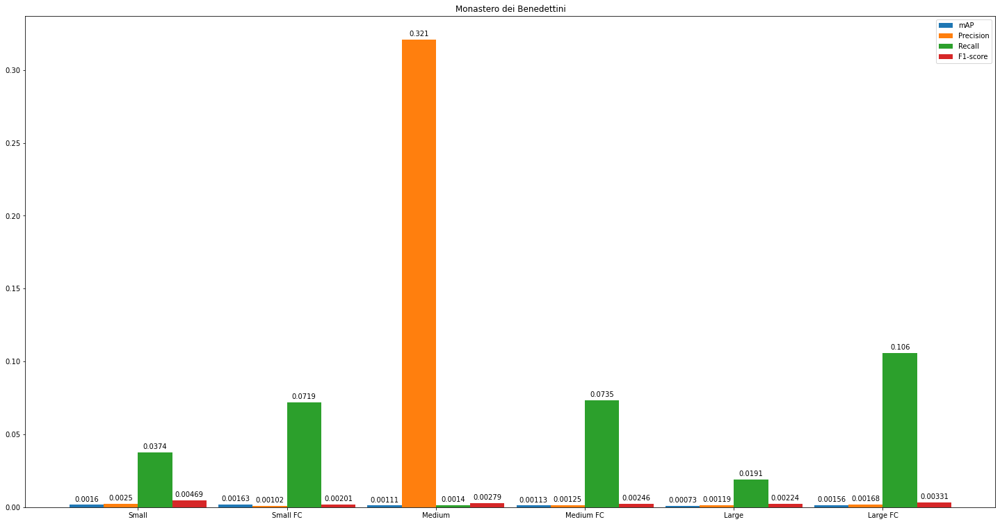

In [ ]:
from matplotlib import pyplot as plt
import numpy as np

mAPs_ben = [0.0016,0.00163,0.00111,0.00113,0.00073,0.00156]
prec_ben = [0.0025,0.00102,0.321,0.00125,0.00119,0.00168]
rec_ben = [0.0374,0.0719,0.0014,0.0735,0.0191,0.106]
f1_ben = calc_f1_list(prec_ben, rec_ben)

labels = ['Small', 'Small FC', 'Medium', 'Medium FC', 'Large', 'Large FC']
x = np.arange(len(labels))
width = 0.23

fig, ax = plt.subplots(figsize=(25,13))
map = ax.bar(x - width*1.5, mAPs_ben, width, label='mAP', align='center')
prec = ax.bar(x - width/2, prec_ben, width, label='Precision', align='center')
rec = ax.bar(x + width/2, rec_ben, width, label='Recall', align='center')
f1 = ax.bar(x + width*1.5, f1_ben, width, label='F1-score', align='center')

ax.set_title('Monastero dei Benedettini')
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.legend()

ax.bar_label(map, padding=3)
ax.bar_label(prec, padding=3)
ax.bar_label(rec, padding=3)
ax.bar_label(f1, padding=3)

plt.show()

## 6.2 - Palazzo Bellomo

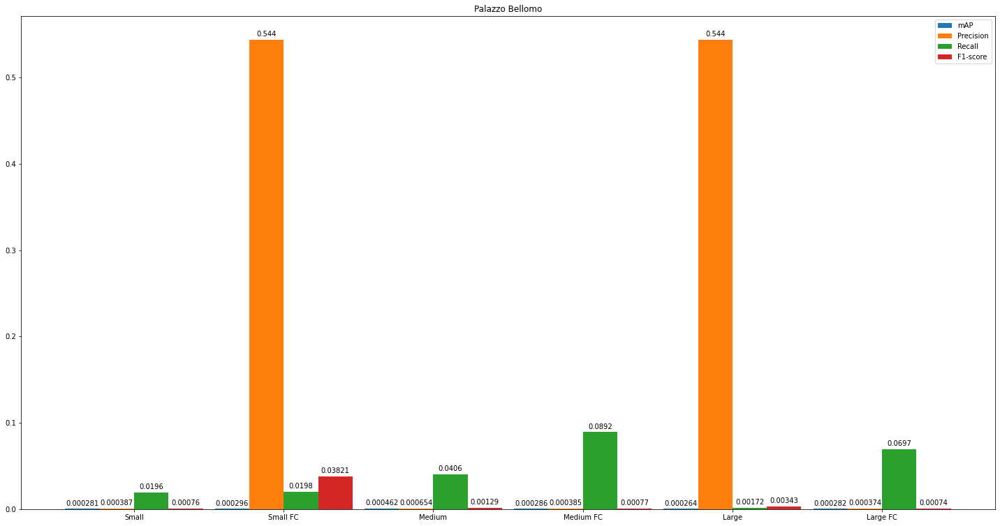

In [ ]:
from matplotlib import pyplot as plt
import numpy as np

mAPs_bell = [0.000281,0.000296,0.000462,0.000286,0.000264,0.000282] 
prec_bell = [0.000387,0.544,0.000654,0.000385,0.544,0.000374]
rec_bell = [0.0196,0.0198,0.0406,0.0892,0.00172,0.0697]
f1_bell = calc_f1_list(prec_bell, rec_bell)

labels = ['Small', 'Small FC', 'Medium', 'Medium FC', 'Large', 'Large FC']
x = np.arange(len(labels))
width = 0.23

fig, ax = plt.subplots(figsize=(25,13))
map = ax.bar(x - width*1.5, mAPs_bell, width, label='mAP', align='center')
prec = ax.bar(x - width/2, prec_bell, width, label='Precision', align='center')
rec = ax.bar(x + width/2, rec_bell, width, label='Recall', align='center')
f1 = ax.bar(x + width*1.5, f1_bell, width, label='F1-score', align='center')

ax.set_title('Palazzo Bellomo')
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.legend()

ax.bar_label(map, padding=3)
ax.bar_label(prec, padding=3)
ax.bar_label(rec, padding=3)
ax.bar_label(f1, padding=3)

plt.show()